**Pumpkin Seeds Dataset**

Abstract: Pumpkin seeds are frequently consumed as confection worldwide because of their adequate amount of protein, fat, carbohydrate, and mineral contents. This study was carried out on the two most important and quality types of pumpkin seeds, ‘‘Urgup_Sivrisi’’ and ‘‘Cercevelik’’, generally grown in Urgup and Karacaoren regions in Turkey. However, morphological measurements of 2500 pumpkin seeds of both varieties were made possible by using the gray and binary forms of threshold techniques. Considering morphological features, all the data were modeled with five different machine learning methods: Logistic Regression (LR), Multilayer Perceptrons (MLP), Support Vector Machine (SVM) and Random Forest (RF), and k-Nearest Neighbor (k-NN), which further determined the most successful method for classifying pumpkin seed varieties. However, the performances of the models were determined with the help of the 10 kfold cross-validation method. The accuracy rates of the classifiers were obtained as LR 87.92 percent, MLP 88.52 percent, SVM 88.64 percent, RF 87.56 percent, and k-NN 87.64 percent.



https://www.kaggle.com/datasets/muratkokludataset/pumpkin-seeds-dataset/data

# Importing Libraries

In [1]:
#!pip install tensorflow

In [2]:
#!pip install --upgrade jax jaxlib

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [3]:
import numpy as np

import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 500)
pd.set_option('display.float_format', lambda x: '%.3f' % x)
pd.set_option('display.max_rows', None)

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
sns.set()
sns.set_style("whitegrid")

import warnings
warnings.filterwarnings("ignore")

from sklearn.preprocessing import StandardScaler, RobustScaler

from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, RandomizedSearchCV

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping
from keras.models import Sequential
from keras.layers import Dense, Dropout,BatchNormalization
from keras.callbacks import EarlyStopping
from keras.utils import to_categorical

# Loading Dataset

In [4]:
!mkdir -p ~/.kaggle # create directory
!cp kaggle.json ~/.kaggle/

In [5]:
#!/bin/bash
!kaggle datasets download muratkokludataset/pumpkin-seeds-dataset

Dataset URL: https://www.kaggle.com/datasets/muratkokludataset/pumpkin-seeds-dataset
License(s): CC0-1.0


In [6]:
import zipfile
with zipfile.ZipFile('pumpkin-seeds-dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('.')

In [ ]:
dataset = pd.read_excel('/kaggle/input/pumpkin-seeds-dataset/Pumpkin_Seeds_Dataset/Pumpkin_Seeds_Dataset.xlsx')
dataset.head()

In [7]:
dataset = pd.read_excel('/content/Pumpkin_Seeds_Dataset/Pumpkin_Seeds_Dataset.xlsx') #, encoding='latin-1',  delimiter='\t')
dataset.head()

,Area,Perimeter,Major_Axis_Length,Minor_Axis_Length,Convex_Area,Equiv_Diameter,Eccentricity,Solidity,Extent,Roundness,Aspect_Ration,Compactness,Class
0,56276,888.242,326.149,220.239,56831,267.680,0.738,0.990,0.745,0.896,1.481,0.821,Çerçevelik
1,76631,1068.146,417.193,234.229,77280,312.361,0.828,0.992,0.715,0.844,1.781,0.749,Çerçevelik
2,71623,1082.987,435.833,211.046,72663,301.982,0.875,0.986,0.740,0.767,2.065,0.693,Çerçevelik
3,66458,992.051,381.564,222.532,67118,290.890,0.812,0.990,0.740,0.849,1.715,0.762,Çerçevelik
4,66107,998.146,383.888,220.454,67117,290.121,0.819,0.985,0.675,0.834,1.741,0.756,Çerçevelik


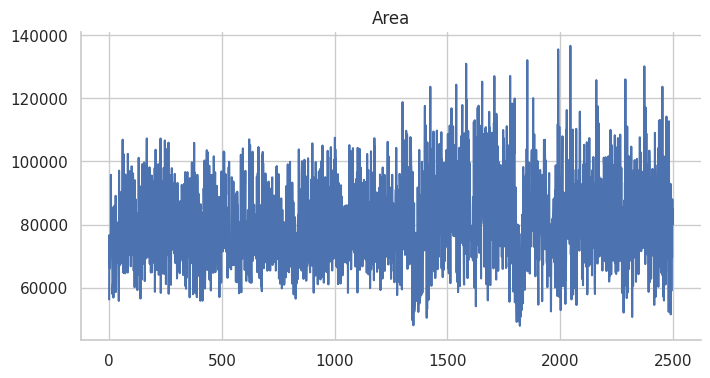

In [8]:
# @title Area

dataset['Area'].plot(kind='line', figsize=(8, 4), title='Area')
plt.gca().spines[['top', 'right']].set_visible(False)

# Sanity Check

In [9]:
dataset.shape

(2500, 13)

In [10]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2500 entries, 0 to 2499
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Area               2500 non-null   int64  
 1   Perimeter          2500 non-null   float64
 2   Major_Axis_Length  2500 non-null   float64
 3   Minor_Axis_Length  2500 non-null   float64
 4   Convex_Area        2500 non-null   int64  
 5   Equiv_Diameter     2500 non-null   float64
 6   Eccentricity       2500 non-null   float64
 7   Solidity           2500 non-null   float64
 8   Extent             2500 non-null   float64
 9   Roundness          2500 non-null   float64
 10  Aspect_Ration      2500 non-null   float64
 11  Compactness        2500 non-null   float64
 12  Class              2500 non-null   object 
dtypes: float64(10), int64(2), object(1)
memory usage: 254.0+ KB


In [11]:
dataset.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Area,2500.000,NaN,NaN,NaN,80658.221,13664.510,47939.000,70765.000,79076.000,89757.500,136574.000
Perimeter,2500.000,NaN,NaN,NaN,1130.279,109.256,868.485,1048.830,1123.672,1203.341,1559.450
Major_Axis_Length,2500.000,NaN,NaN,NaN,456.602,56.236,320.845,414.958,449.497,492.738,661.911
Minor_Axis_Length,2500.000,NaN,NaN,NaN,225.795,23.297,152.172,211.246,224.703,240.673,305.818
Convex_Area,2500.000,NaN,NaN,NaN,81508.084,13764.093,48366.000,71512.000,79872.000,90797.750,138384.000
Equiv_Diameter,2500.000,NaN,NaN,NaN,319.334,26.892,247.058,300.168,317.305,338.057,417.003
Eccentricity,2500.000,NaN,NaN,NaN,0.861,0.045,0.492,0.832,0.864,0.897,0.948
Solidity,2500.000,NaN,NaN,NaN,0.989,0.003,0.919,0.988,0.990,0.992,0.994
Extent,2500.000,NaN,NaN,NaN,0.693,0.061,0.468,0.659,0.713,0.740,0.830
Roundness,2500.000,NaN,NaN,NaN,0.792,0.056,0.555,0.752,0.798,0.834,0.940


In [12]:
dataset.duplicated().sum()

np.int64(0)

In [13]:
dataset.duplicated().any()

np.False_

In [14]:
dataset.isnull().sum()

,0
Area,0
Perimeter,0
Major_Axis_Length,0
Minor_Axis_Length,0
Convex_Area,0
Equiv_Diameter,0
Eccentricity,0
Solidity,0
Extent,0
Roundness,0


# Checking Distributiion of Dependent Variable

In [15]:
dataset['Class'].value_counts(normalize=True)

,proportion
Class,
Çerçevelik,0.520
Ürgüp Sivrisi,0.480


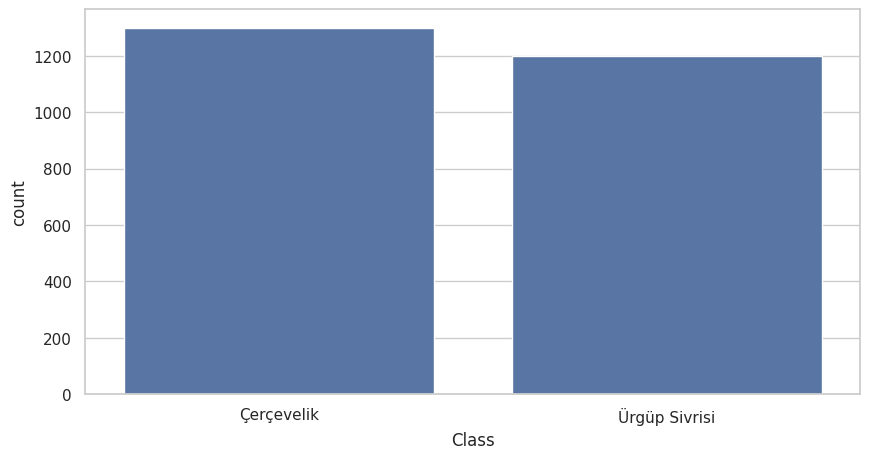

In [16]:
plt.figure(figsize=(10, 5))
sns.countplot(x='Class', data=dataset)
plt.show()

# Encoding Categorical Feature

In [17]:
dataset['Class'].unique()

array(['Çerçevelik', 'Ürgüp Sivrisi'], dtype=object)

In [18]:
dataset['Class'] = dataset['Class'].map({'Çerçevelik':0, 'Ürgüp Sivrisi':1})
dataset.head()

,Area,Perimeter,Major_Axis_Length,Minor_Axis_Length,Convex_Area,Equiv_Diameter,Eccentricity,Solidity,Extent,Roundness,Aspect_Ration,Compactness,Class
0,56276,888.242,326.149,220.239,56831,267.680,0.738,0.990,0.745,0.896,1.481,0.821,0
1,76631,1068.146,417.193,234.229,77280,312.361,0.828,0.992,0.715,0.844,1.781,0.749,0
2,71623,1082.987,435.833,211.046,72663,301.982,0.875,0.986,0.740,0.767,2.065,0.693,0
3,66458,992.051,381.564,222.532,67118,290.890,0.812,0.990,0.740,0.849,1.715,0.762,0
4,66107,998.146,383.888,220.454,67117,290.121,0.819,0.985,0.675,0.834,1.741,0.756,0


In [19]:
dataset['Class'].value_counts()

,count
Class,
0,1300
1,1200


# Basic EDA

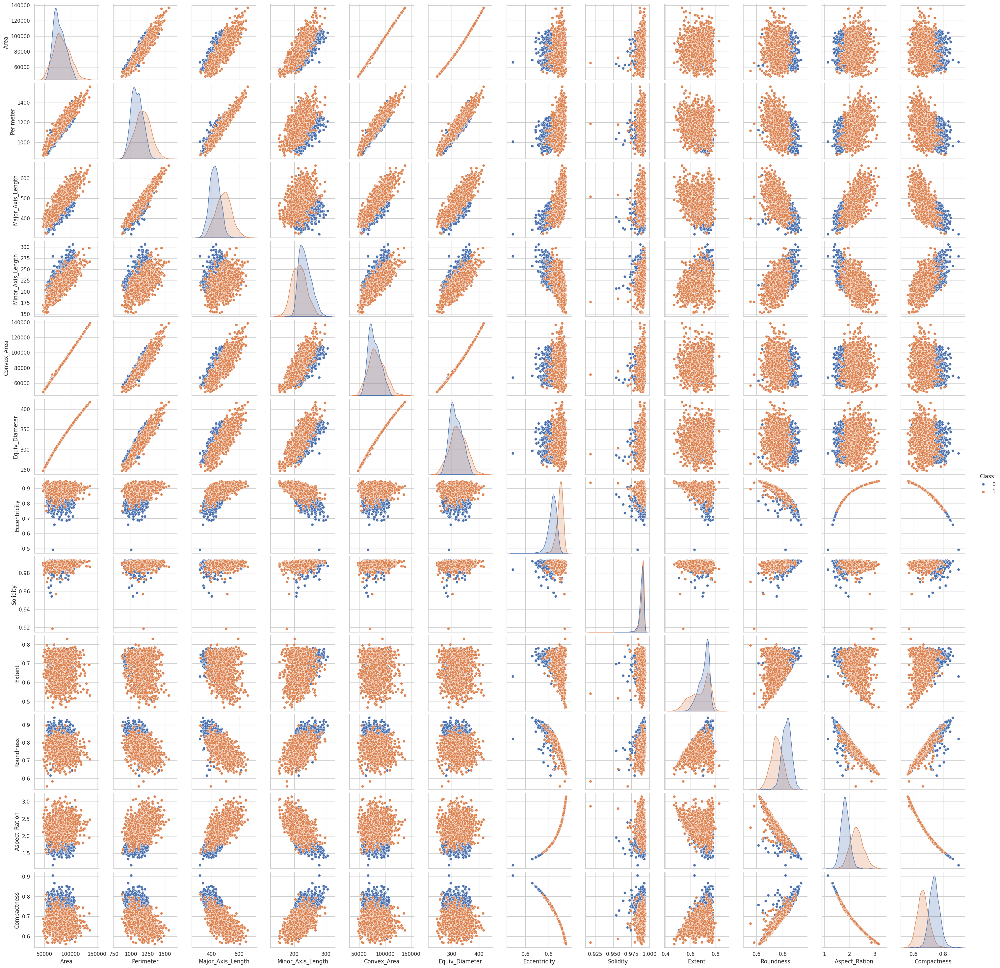

In [20]:
sns.pairplot(dataset, hue='Class')
plt.show()

**Feature Distribution**
- Eccentricity, Aspect_Ratio,Roundness and Compactness: Show some degree of separation between classes in their distributions.

- Other features like Area, Major_Axis_Length, and Perimeter appear to have similar distributions between classes — less discriminative individually

**Feature Relationships & Class Separation**
**Linear Trend and Correlation**
- Area vs. Major_Axis_Length, Minor_Axis_Length, and Perimeter show strong positive linear relationships.

- Perimeter vs. Major/Minor_Axis_Length also show linear trends.



Useful for Class Separation:

- Compactness shows clustering or better separation between Class 0 and Class 1.

- Eccentricity vs. Aspect_Ratio shows a distinct curve pattern, with some separation between classes.




In [21]:
def hist_box_plot(dataset, col):
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    sns.histplot(data=dataset, x=col, kde=True, hue='Class', ax=axes[0])
    sns.boxplot(y=col, x='Class', data=dataset, ax=axes[1])
    print(dataset.groupby('Class')[col].describe())
    plt.show()

In [22]:
stats_based_on_class = dataset.groupby('Class').describe().T
stats_based_on_class

Class                            0          1
Area              count   1300.000   1200.000
                  mean   78423.155  83079.542
                  std    11246.500  15519.324
                  min    55811.000  47939.000
                  25%    69777.750  72482.500
                  50%    76718.500  81657.000
                  75%    86277.750  93815.750
                  max   107476.000 136574.000
Perimeter         count   1300.000   1200.000
                  mean    1089.522   1174.432
                  std       83.128    116.793
                  min      888.242    868.485
                  25%     1027.614   1097.747
                  50%     1083.189   1173.716
                  75%     1146.549   1254.794
                  max     1416.303   1559.450
Major_Axis_Length count   1300.000   1200.000
                  mean     426.273    489.459
                  std       37.197     54.904
                  min      320.845    324.011
                  25%      399.972    451.871
                  50%      425.427    491.518
                  75%      451.430    526.521
                  max      614.896    661.911
Minor_Axis_Length count   1300.000   1200.000
                  mean     234.777    216.064
                  std       19.501     23.174
                  min      185.844    152.172
                  25%      219.773    199.329
                  50%      232.094    215.295
                  75%      247.596    231.376
                  max      305.818    297.795
Convex_Area       count   1300.000   1200.000
                  mean   79286.488  83914.813
                  std    11350.508  15624.712
                  min    56394.000  48366.000
                  25%    70522.000  73267.750
                  50%    77525.500  82446.500
                  75%    87213.500  94804.500
                  max   108536.000 138384.000
Equiv_Diameter    count   1300.000   1200.000
                  mean     315.193    323.820
                  std       22.473     30.355
                  min      266.572    247.058
                  25%      298.067    303.789
                  50%      312.540    322.442
                  75%      331.440    345.615
                  max      369.923    417.003
Eccentricity      count   1300.000   1200.000
                  mean       0.831      0.894
                  std        0.036      0.027
                  min        0.492      0.751
                  25%        0.811      0.879
                  50%        0.835      0.898
                  75%        0.856      0.912
                  max        0.936      0.948
Solidity          count   1300.000   1200.000
                  mean       0.989      0.990
                  std        0.003      0.004
                  min        0.954      0.919
                  25%        0.988      0.989
                  50%        0.990      0.991
                  75%        0.991      0.992
                  max        0.994      0.994
Extent            count   1300.000   1200.000
                  mean       0.707      0.678
                  std        0.041      0.074
                  min        0.507      0.468
                  25%        0.681      0.621
                  50%        0.718      0.698
                  75%        0.739      0.742
                  max        0.781      0.830
Roundness         count   1300.000   1200.000
                  mean       0.827      0.753
                  std        0.037      0.046
                  min        0.615      0.555
                  25%        0.803      0.724
                  50%        0.830      0.752
                  75%        0.852      0.784
                  max        0.940      0.897
Aspect_Ration     count   1300.000   1200.000
                  mean       1.823      2.279
                  std        0.169      0.263
                  min        1.149      1.514
                  25%        1.708      2.100
                  50%        1.819      2.26

         count      mean       std       min       25%       50%       75%        max
Class                                                                                
0     1300.000 78423.155 11246.500 55811.000 69777.750 76718.500 86277.750 107476.000
1     1200.000 83079.542 15519.324 47939.000 72482.500 81657.000 93815.750 136574.000


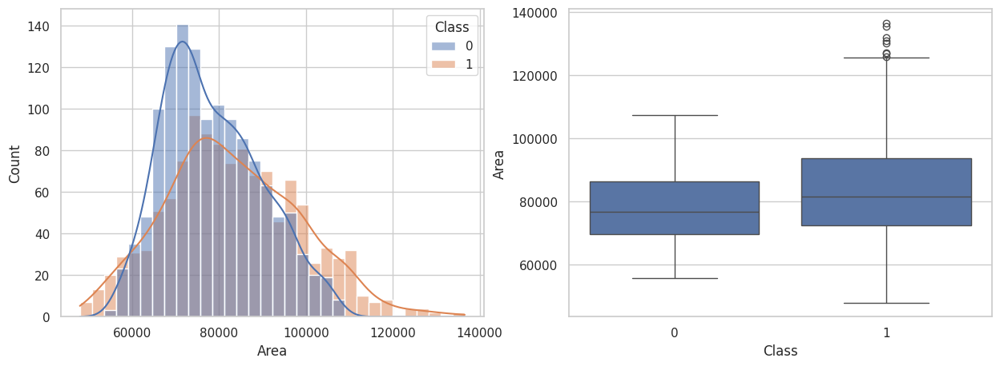

Class
0   76718.500
1   81657.000
Name: Area, dtype: float64


In [23]:
hist_box_plot(dataset, 'Area')
print(dataset.groupby('Class')['Area'].median())

**Histogram**

- Class 0: The distribution of 'Area' for Class 0 appears to be roughly normally distributed, with a peak around the mid-70,000s. The spread of the data is relatively contained.

- Class 1: The distribution of 'Area' for Class 1 is more spread out and appears to be skewed to the right (longer tail on the higher end). The peak of this distribution seems to be slightly higher than that of Class 0, around the low to mid-80,000s.

**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Area' value around the mid-70,000s. The interquartile range (IQR) is relatively smaller, indicating less variability in the central 50% of the data. There are a few potential outliers on the higher end.

- Class 1: The box plot for Class 1 shows a slightly higher median 'Area' value compared to Class 0, likely in the low 80,000s. The IQR is larger, indicating greater variability in the central 50% of the data. There are also several outliers on the higher end.

- 'Area' tends to be larger for Class 1 compared to Class 0, and the 'Area' values for Class 1 have a wider range and more outliers on the higher side.


         count     mean     std     min      25%      50%      75%      max
Class                                                                      
0     1300.000 1089.522  83.128 888.242 1027.614 1083.189 1146.549 1416.303
1     1200.000 1174.432 116.793 868.485 1097.747 1173.716 1254.794 1559.450


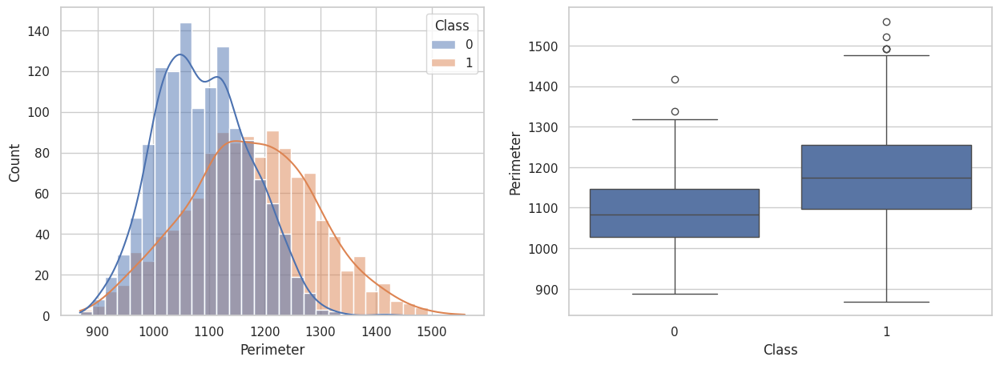

In [24]:
hist_box_plot(dataset, 'Perimeter')

**Histogram**

- Class 0: The distribution of 'Perimeter' for Class 0 appears to be roughly normally distributed, with a peak around 1050-1100. The spread of the data is relatively contained.
- Class 1: The distribution of 'Perimeter' for Class 1 is shifted to the right compared to Class 0. The peak of this distribution seems to be around 1200-1250. The distribution also appears somewhat wider than that of Class 0.
- There is some overlap between the two distributions, indicating that 'Perimeter' alone is not a perfect separator between the two classes. However, there is a clear tendency for Class 1 to have higher 'Perimeter' values.

**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Perimeter' value around 1100. The interquartile range (IQR) is relatively smaller, indicating less variability in the central 50% of the data. There are a few potential outliers on the higher end.
- Class 1: The box plot for Class 1 shows a higher median 'Perimeter' value compared to Class 0, around 1200. The IQR is also larger, indicating greater variability in the central 50% of the data. There are several outliers on the higher end.
- The box plots visually confirm that, on average, the 'Perimeter' tends to be larger for Class 1 compared to Class 0, and the 'Perimeter' values for Class 1 have a wider spread and more outliers on the higher side.



         count    mean    std     min     25%     50%     75%     max
Class                                                                
0     1300.000 426.273 37.197 320.845 399.972 425.427 451.430 614.896
1     1200.000 489.459 54.904 324.011 451.871 491.518 526.521 661.911


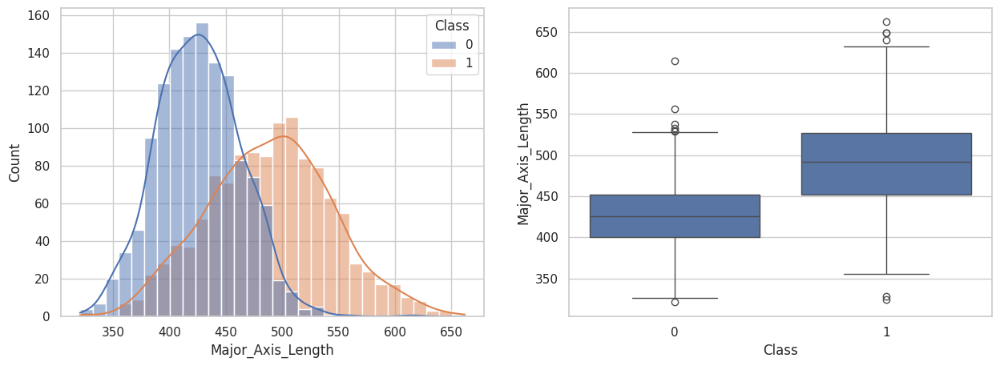

In [25]:
hist_box_plot(dataset, 'Major_Axis_Length')

**Histogram**

- Class 0: The distribution of 'Major_Axis_Length' for Class 0 appears to be roughly normally distributed, with a peak around 420-440. The spread of the data is relatively contained.
- Class 1: The distribution of 'Major_Axis_Length' for Class 1 is shifted to the right compared to Class 0. The peak of this distribution seems to be around 500-520. The distribution also appears somewhat wider than that of Class 0. Class 1 have larger 'Major_Axis_Length' values


**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Major_Axis_Length' value around 440. The interquartile range (IQR) is relatively smaller, indicating less variability in the central 50% of the data. There are a few potential outliers on the higher end and a couple on the lower end.
- Class 1: The box plot for Class 1 shows a higher median 'Major_Axis_Length' value compared to Class 0, around 500. The IQR is also larger, indicating greater variability in the central 50% of the data. There are several outliers on the higher end. Class 1 have a wider spread and more outliers on the higher side.



         count    mean    std     min     25%     50%     75%     max
Class                                                                
0     1300.000 234.777 19.501 185.844 219.773 232.094 247.596 305.818
1     1200.000 216.064 23.174 152.172 199.329 215.295 231.376 297.795


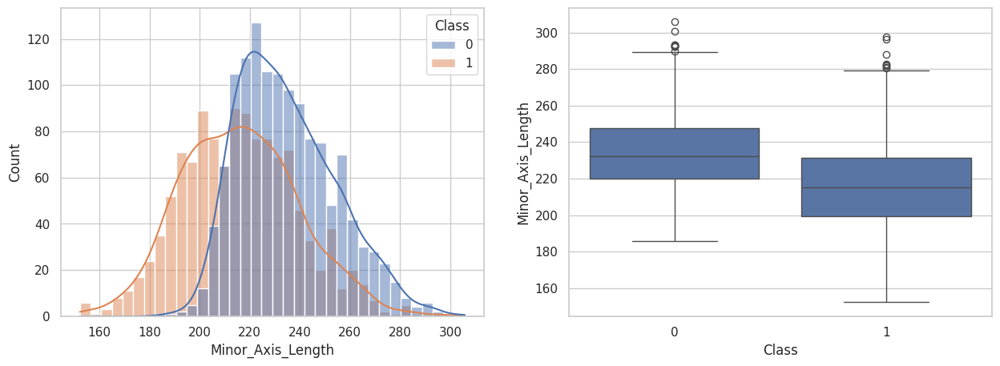

In [26]:
hist_box_plot(dataset, 'Minor_Axis_Length')

**Histogram**

- Class 0: The distribution of 'Minor_Axis_Length' for Class 0 appears to be roughly normally distributed, with a peak around 220-230. The spread of the data is relatively contained.
- Class 1: The distribution of 'Minor_Axis_Length' for Class 1 is shifted to the left compared to Class 0. The peak of this distribution seems to be around 200-210. The distribution also appears somewhat wider than that of Class 0.


**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Minor_Axis_Length' value around 230. The interquartile range (IQR) is relatively small. There are a few potential outliers on the higher end.
- Class 1: The box plot for Class 1 shows a lower median 'Minor_Axis_Length' value compared to Class 0, around 210. The IQR is also relatively small. There are a few potential outliers on the higher end. Averagefor class 1 is smaller than class 0.
- The spread of the central 50% of the data appears similar for both classes.




         count      mean       std       min       25%       50%       75%        max
Class                                                                                
0     1300.000 79286.488 11350.508 56394.000 70522.000 77525.500 87213.500 108536.000
1     1200.000 83914.813 15624.712 48366.000 73267.750 82446.500 94804.500 138384.000


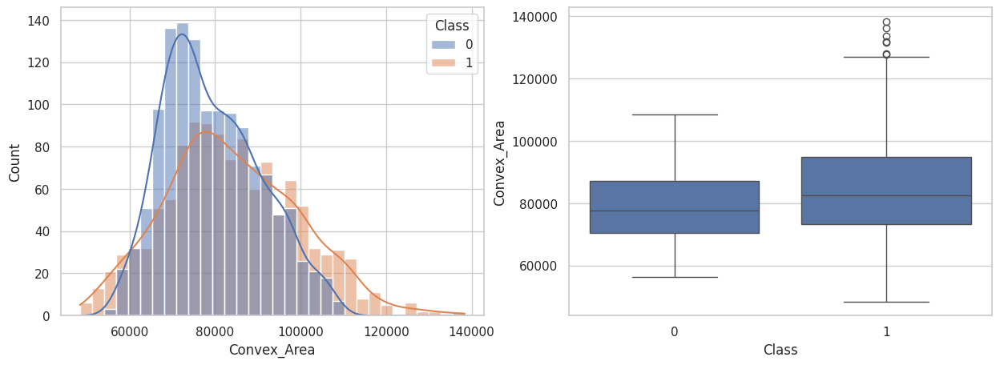

In [27]:
hist_box_plot(dataset, 'Convex_Area')

**Histogram**

- Class 0: The distribution of 'Convex_Area' for Class 0 appears to be roughly normally distributed, with a peak around the mid-70,000s. The spread of the data is relatively contained.
- Class 1: The distribution of 'Convex_Area' for Class 1 is shifted to the right compared to Class 0. The peak of this distribution seems to be around the low to mid-80,000s. The distribution also appears somewhat wider than that of Class 0, with a longer tail extending towards higher values.


**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Convex_Area' value around the mid-70,000s. The interquartile range (IQR) is relatively smaller, indicating less variability in the central 50% of the data. There are a few potential outliers on the higher end.
- Class 1: The box plot for Class 1 shows a higher median 'Convex_Area' value compared to Class 0, around the low 80,000s. The IQR is larger, indicating greater variability in the central 50% of the data. There are several outliers on the higher end.





         count    mean    std     min     25%     50%     75%     max
Class                                                                
0     1300.000 315.193 22.473 266.572 298.067 312.540 331.440 369.923
1     1200.000 323.820 30.355 247.058 303.789 322.442 345.615 417.003


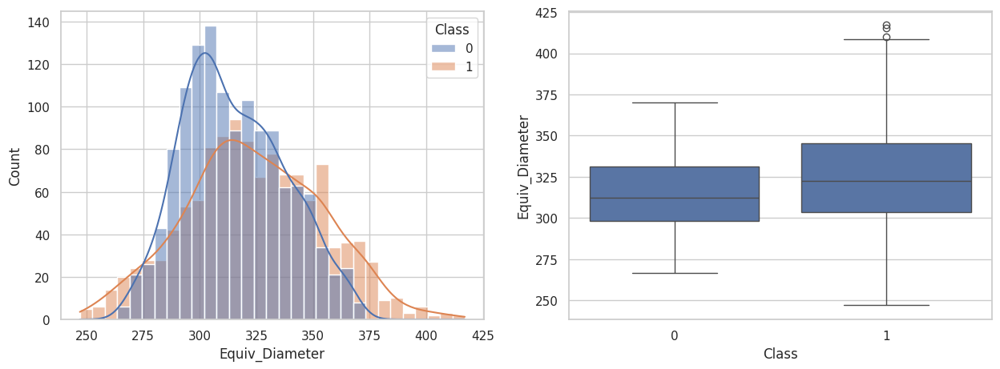

In [28]:
hist_box_plot(dataset, 'Equiv_Diameter')

**Histogram**

- Class 0: The distribution of 'Equiv_Diameter' for Class 0 appears to be roughly normally distributed, with a peak around 300-310. The spread of the data is relatively contained.
- Class 1: The distribution of 'Equiv_Diameter' for Class 1 is shifted to the right compared to Class 0. The peak of this distribution seems to be around 330-340. The distribution also appears somewhat wider than that of Class 0, with a longer tail extending towards higher values.


**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Equiv_Diameter' value around 315-320. The interquartile range (IQR) is relatively smaller, indicating less variability in the central 50% of the data. There are a few potential outliers on the higher end.
- Class 1: The box plot for Class 1 shows a higher median 'Equiv_Diameter' value compared to Class 0, around 340. The IQR is larger, indicating greater variability in the central 50% of the data. There are several outliers on the higher end.



         count  mean   std   min   25%   50%   75%   max
Class                                                   
0     1300.000 0.831 0.036 0.492 0.811 0.835 0.856 0.936
1     1200.000 0.894 0.027 0.751 0.879 0.898 0.912 0.948


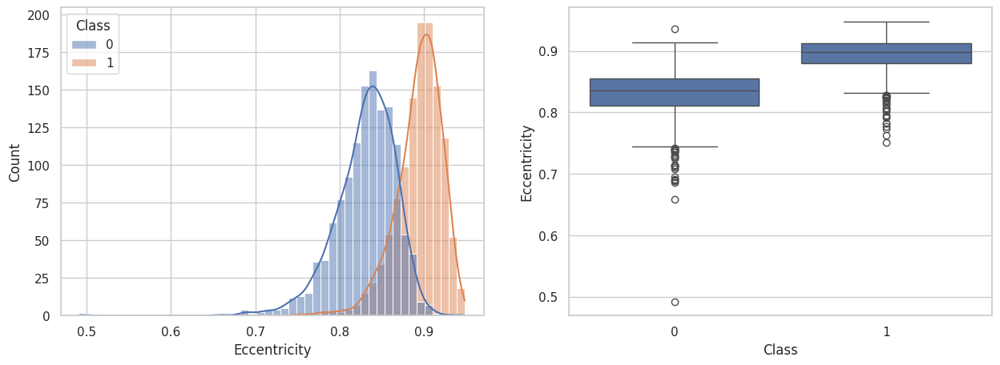

In [29]:
hist_box_plot(dataset, 'Eccentricity')

**Histogram**

- Class 0: The distribution of 'Eccentricity' for Class 0 is heavily skewed to the right, with a peak around 0.85-0.90. The majority of the data points are concentrated in the higher range of eccentricity values.
- Class 1: The distribution of 'Eccentricity' for Class 1 is also skewed to the right, but its peak is noticeably higher, around 0.90-0.95. The data points for Class 1 are even more concentrated towards the higher end of the eccentricity scale compared to Class 0.


**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Eccentricity' value around 0.86. The interquartile range (IQR) is relatively small and located in the higher end of the eccentricity scale. There are several outliers on the lower end.
- Class 1: The box plot for Class 1 shows a higher median 'Eccentricity' value compared to Class 0, around 0.91. The IQR is also relatively small and located at even higher eccentricity values. There are also some outliers on the lower end, but fewer than in Class 0.
- Central tendency of 'Eccentricity' is higher for Class 1 than for Class 0. IQR for Class 1 is relatively smaller than Class 0




         count  mean   std   min   25%   50%   75%   max
Class                                                   
0     1300.000 0.989 0.003 0.954 0.988 0.990 0.991 0.994
1     1200.000 0.990 0.004 0.919 0.989 0.991 0.992 0.994


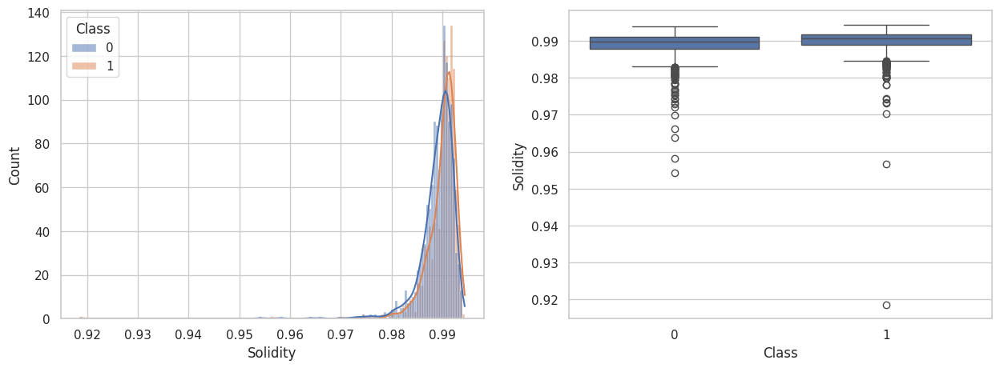

In [30]:
hist_box_plot(dataset, 'Solidity')

**Histogram**

- Class 0: The distribution of 'Solidity' for Class 0 is heavily concentrated in a very narrow range at the higher end, mostly between 0.98 and 1.0. The peak of the distribution is very sharp, suggesting most instances have very high solidity. There's a slight tail extending towards lower solidity values, but the count is very low.
- Class 1: The distribution of 'Solidity' for Class 1 is also heavily concentrated at the higher end, mostly between 0.98 and 1.0. The peak is also very sharp and appears to be slightly shifted towards even higher solidity values compared to Class 0. The tail extending towards lower solidity values seems even less pronounced than in Class 0.


**Boxplot**
- Class 0: The box plot for Class 0 shows a median 'Solidity' value very close to 0.99. The IQR is extremely small, indicating very low variability in the central 50% of the data, all at very high solidity values. There are several outliers on the lower end, some significantly lower than the bulk of the data.
- Class 1: The box plot for Class 1 also shows a median 'Solidity' value very close to 0.99, perhaps slightly higher than Class 0. The IQR is also extremely small, indicating very low variability at very high solidity values. There are also some outliers on the lower end, but they appear to be fewer and generally closer to the main distribution compared to Class 0.





         count  mean   std   min   25%   50%   75%   max
Class                                                   
0     1300.000 0.707 0.041 0.507 0.681 0.718 0.739 0.781
1     1200.000 0.678 0.074 0.468 0.621 0.698 0.742 0.830


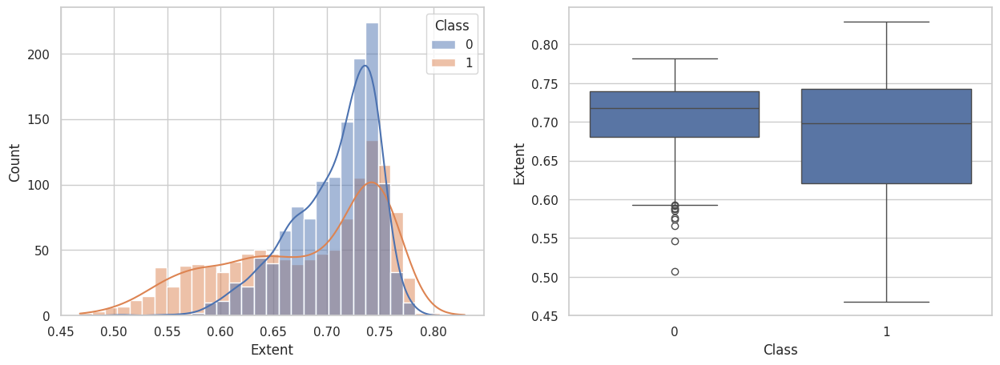

In [31]:
hist_box_plot(dataset, 'Extent')

**Histogram**

- Class 0 (blue) has a more concentrated distribution of 'Extent' values, with a sharp peak around 0.72 - 0.74
- Class 1 (orange) has a wider spread, with values ranging from about 0.48 to 0.82, and a flatter peak around 0.72. Class 1 has a notable left skew, with more samples having smaller 'Extent' values compared to Class 0.


**Boxplot**
- Median for both classes is similar (just above 0.70), but:
  - Class 0 has a narrower IQR, suggesting lower variability.
  - Class 1 has a larger spread, indicating more variability in 'Extent'.

- Class 0 has a few lower outliers, while Class 1 has a broader range extending down to around 0.46



         count  mean   std   min   25%   50%   75%   max
Class                                                   
0     1300.000 0.827 0.037 0.615 0.803 0.830 0.852 0.940
1     1200.000 0.753 0.046 0.555 0.724 0.752 0.784 0.897


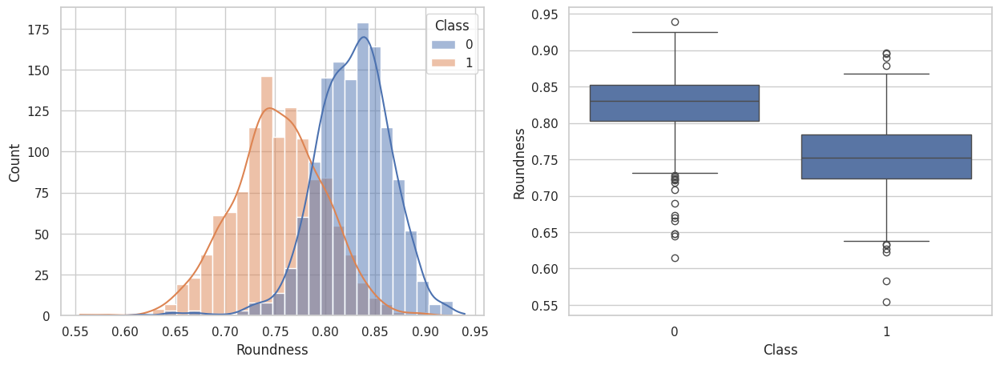

In [32]:
hist_box_plot(dataset, 'Roundness')

**Histogram**
- Class 0: Has a higher roundness on average. The distribution is centered around ~0.83.
- Class 1: Tends to have lower roundness values, centered around ~0.75.

**Box Plot**
- Class 0: Higher median roundness. Less spread and fewer extreme outliers
- Class 1: Lower median. Wider spread and more outliers.

         count  mean   std   min   25%   50%   75%   max
Class                                                   
0     1300.000 1.823 0.169 1.149 1.708 1.819 1.932 2.841
1     1200.000 2.279 0.263 1.514 2.100 2.269 2.443 3.144


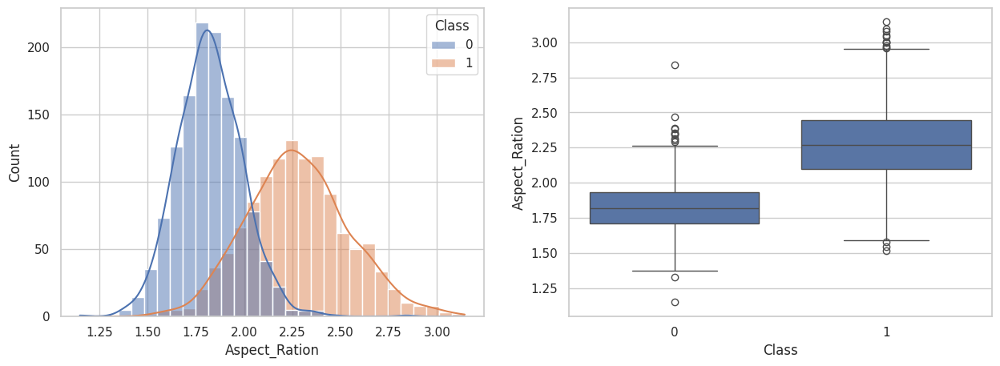

In [33]:
hist_box_plot(dataset, 'Aspect_Ration')

**Histogram**
- Class 0: Centered around ~1.8. The distribution is narrow and symmetric, indicating consistent aspect ratios
- Class 1: Centered around ~2.3 with a longer right tail (positive skew). Much more spread than Class 0.

**Box Plot**
- Class 0: Lower median (~1.8). Tighter interquartile range (IQR), fewer high outliers
- Class 1: Higher median (~2.3). Broader range with many outliers, especially on the higher end.


         count  mean   std   min   25%   50%   75%   max
Class                                                   
0     1300.000 0.741 0.034 0.588 0.718 0.740 0.763 0.905
1     1200.000 0.664 0.039 0.561 0.638 0.663 0.689 0.810


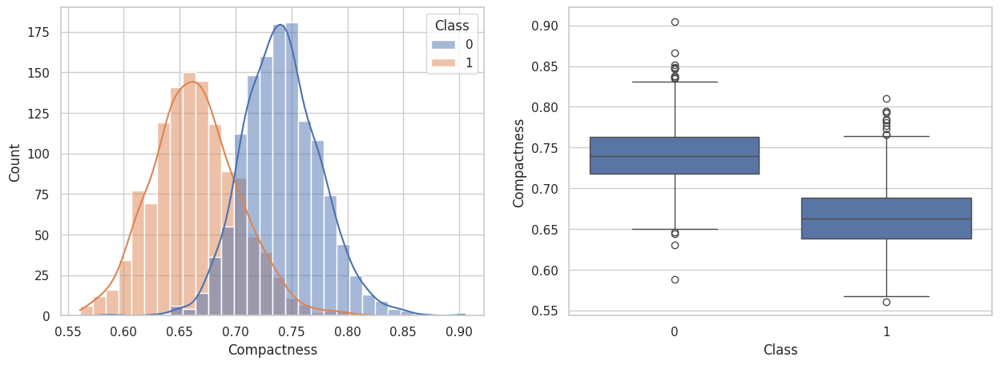

In [34]:
hist_box_plot(dataset, 'Compactness')

**Histogram**
- Class 0: distribution that peaks around 0.73 to 0.75, with most values between 0.70 and 0.80.
- Class 1: peaks around 0.65 to 0.67, with most values between 0.60 and 0.70

**Box Plot**
- Class 0: higher median compactness than Class 1. Have slightly wider interquartile range (IQR)
- Class 1: Lower Median. Wider IQR compared to Class 0.
- Both classes have a fair number of outliers, especially on the higher end.


In [35]:
full_features = dataset.columns.tolist()
full_features.remove('Class')
full_features

['Area',
 'Perimeter',
 'Major_Axis_Length',
 'Minor_Axis_Length',
 'Convex_Area',
 'Equiv_Diameter',
 'Eccentricity',
 'Solidity',
 'Extent',
 'Roundness',
 'Aspect_Ration',
 'Compactness']

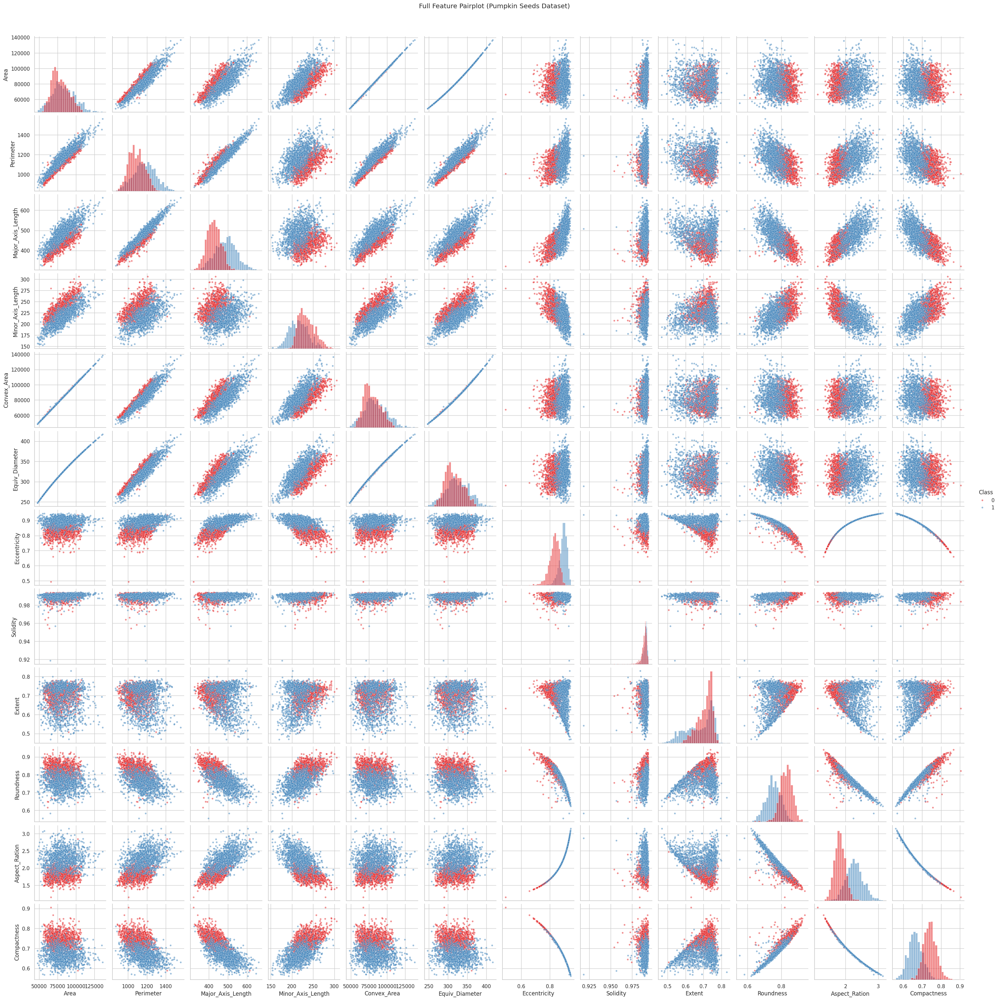

'\nfull_pairplot_path = "/mnt/data/pairplot_full_fixed.png"\npairplot_full.savefig(full_pairplot_path)\nfull_pairplot_path'

In [36]:
# Create pairplot with histogram on diagonal instead of KDE
pairplot_full = sns.pairplot(dataset[full_features + ['Class']],
                              hue='Class',
                              plot_kws={"alpha": 0.5, "s": 15},
                              diag_kind='hist',
                              palette='Set1')
pairplot_full.fig.suptitle("Full Feature Pairplot (Pumpkin Seeds Dataset)", y=1.02)
plt.show()
"""
full_pairplot_path = "/mnt/data/pairplot_full_fixed.png"
pairplot_full.savefig(full_pairplot_path)
full_pairplot_path"""


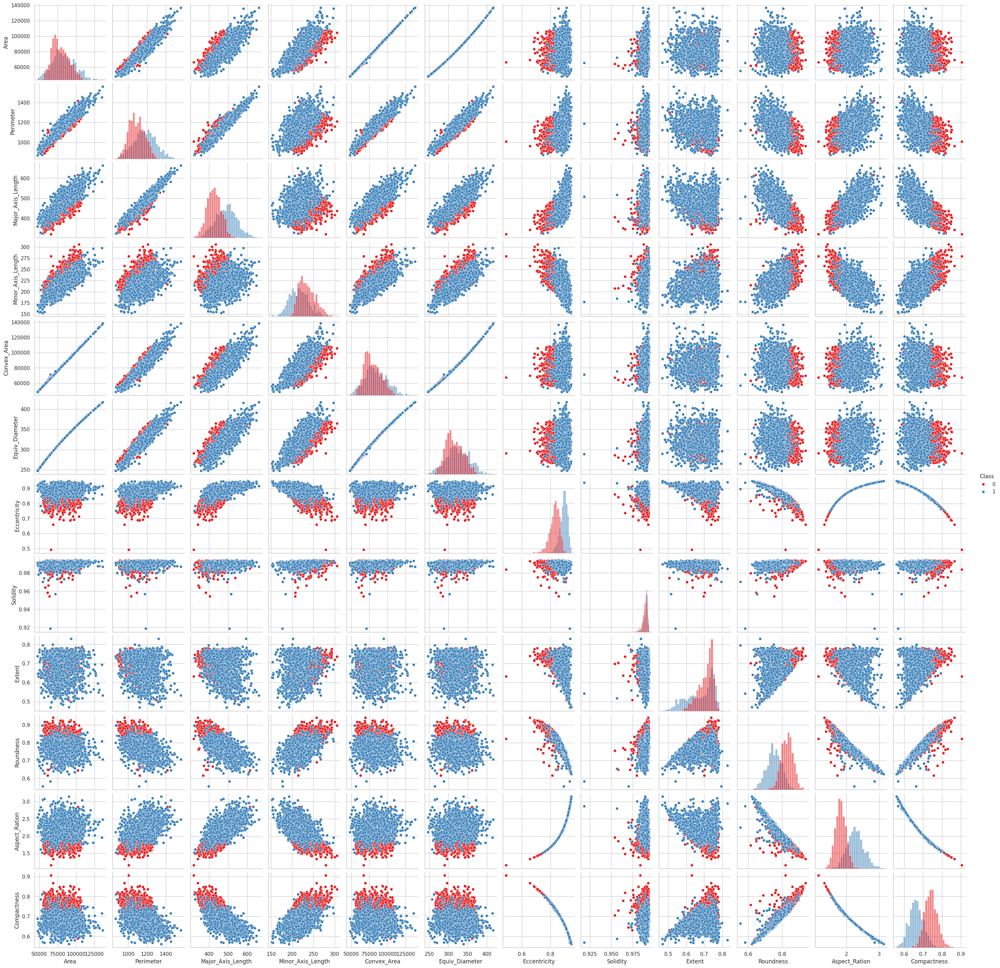

In [37]:
sns.pairplot(dataset, hue='Class', diag_kind='hist', palette='Set1')
plt.show()

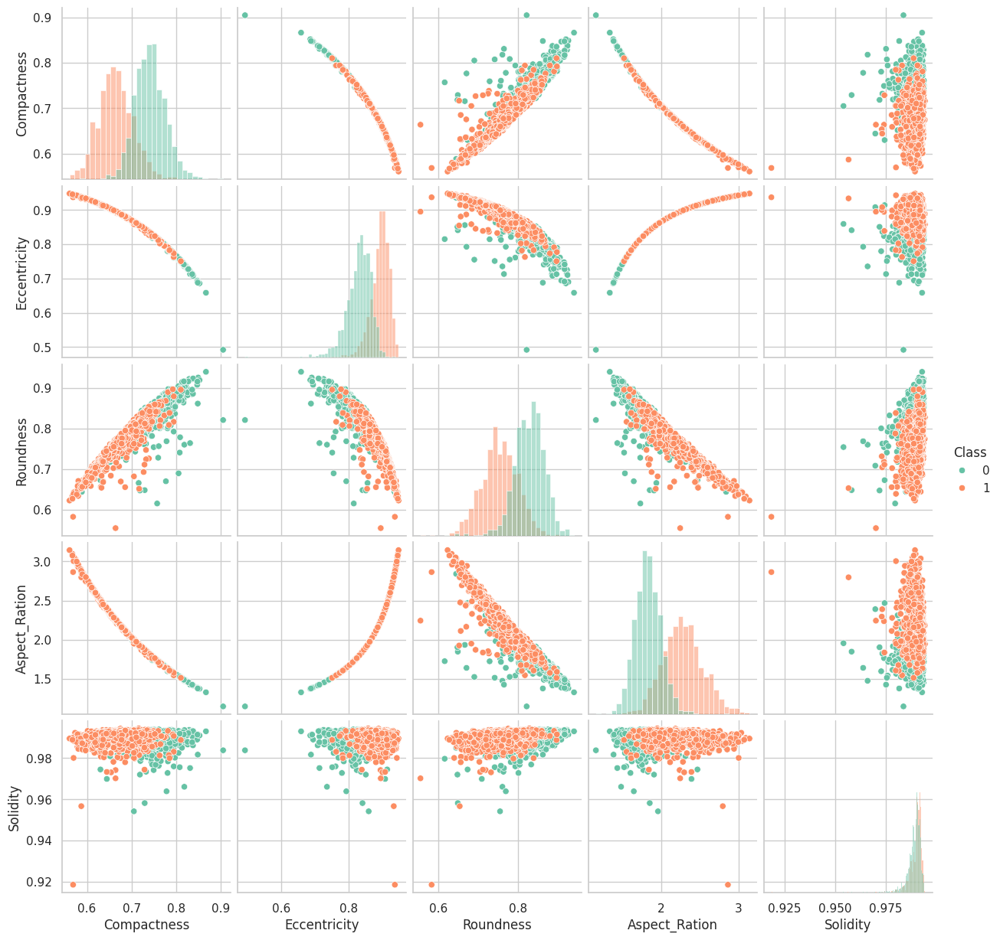

In [38]:
# Focused Pairplot
selected_features = ['Compactness', 'Eccentricity', 'Roundness', 'Aspect_Ration', 'Solidity', 'Class']
sns.pairplot(dataset[selected_features], hue='Class', diag_kind='hist', palette='Set2')
plt.show()

# PCA

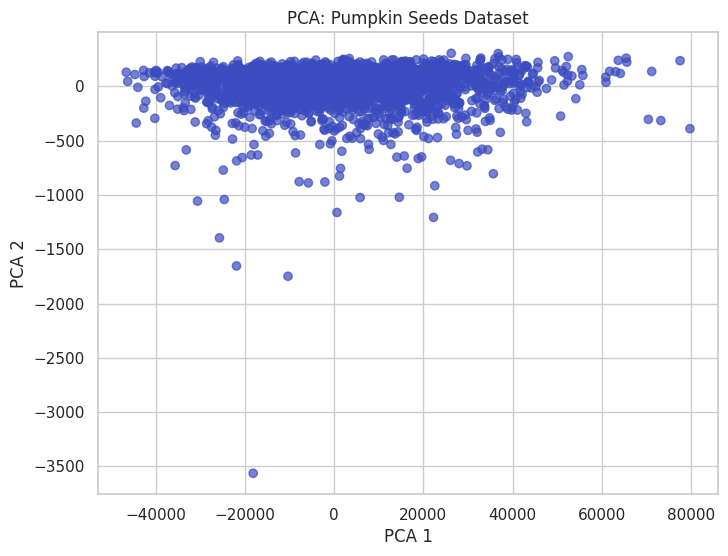

In [39]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

X = dataset.drop('Class', axis=1)
y = dataset['Class']

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(8,6))
plt.scatter(X_pca[:,0], X_pca[:,1], c=(y=='Class 1'), cmap='coolwarm', alpha=0.7)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.title('PCA: Pumpkin Seeds Dataset')
plt.show()


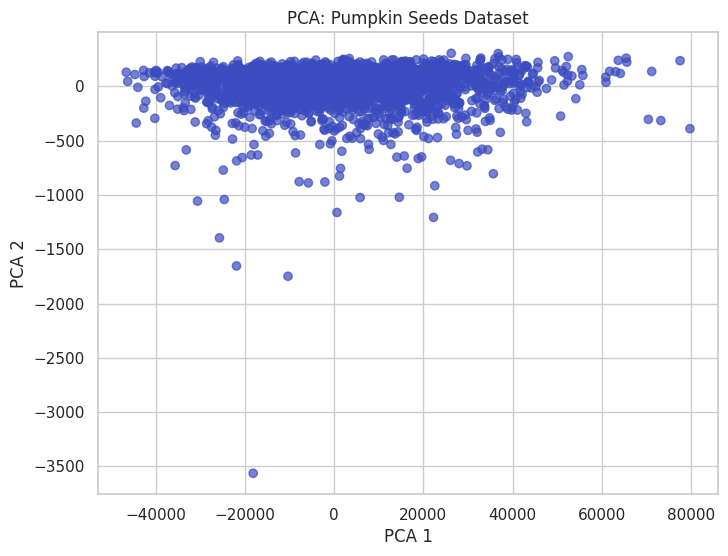

In [40]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

X = dataset.drop('Class', axis=1)
y = dataset['Class']

pca = PCA(n_components=3)
X_pca = pca.fit_transform(X)

plt.figure(figsize=(8,6))
plt.scatter(X_pca[:,0], X_pca[:,1], c=(y=='Class 1'), cmap='coolwarm', alpha=0.7)
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.title('PCA: Pumpkin Seeds Dataset')
plt.show()

# PCA 1 (x-axis) represents the direction of maximum variance in the data. PCA 2 (y-axis) represents the direction of the second-most variance, orthogonal (perpendicular) to PCA 1.

In [41]:
pca.explained_variance_ratio_

array([9.99894675e-01, 9.72274856e-05, 7.89258111e-06])

In [42]:
#pip install ipympl jupyterlab "ipywidgets>=7.6"

In [43]:
#pip install ipympl

In [44]:
#!pip install ipympl jupyterlab "ipywidgets>=7.6"

In [45]:
#import matplotlib
#matplotlib.use('module://ipympl.backend_nbagg')


#%matplotlib widget

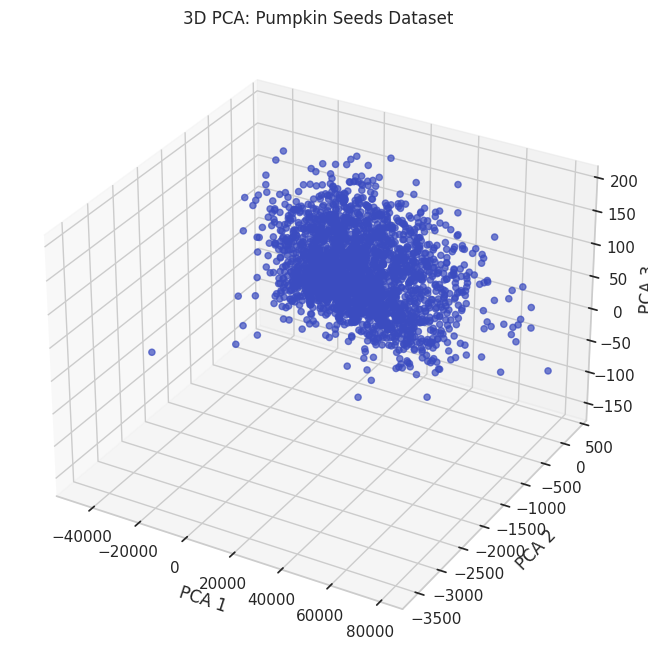

In [46]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
# Create the 3D scatter plot
# Uses the first three principal components for the axes
scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],
                     c=(y == 'Class 1'),  # Color points based on 'Class 1'
                     cmap='coolwarm',    # Use the coolwarm colormap
                     alpha=0.7)          # Set transparency
# Set labels and title
ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')
ax.set_zlabel('PCA 3')
ax.set_title('3D PCA: Pumpkin Seeds Dataset')
# Display the plot
plt.show()


# t-SNE

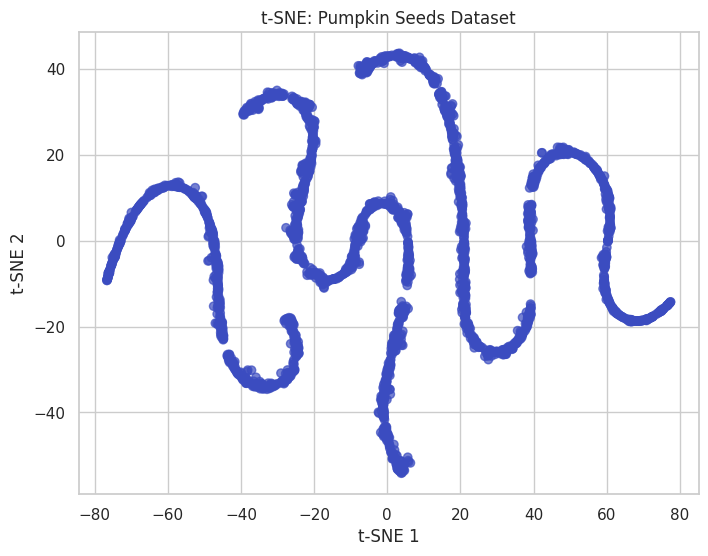

In [47]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

plt.figure(figsize=(8,6))
plt.scatter(X_tsne[:,0], X_tsne[:,1], c=(y=='Class 1'), cmap='coolwarm', alpha=0.7)
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.title('t-SNE: Pumpkin Seeds Dataset')
plt.show()


# Feature Selection

In [48]:
from sklearn.feature_selection import f_classif

f_scores, p_values = f_classif(X, y)
ranking = pd.DataFrame({'Feature': X.columns, 'F-Score': f_scores}).sort_values(by='F-Score', ascending=False)
print(ranking)


              Feature  F-Score
11        Compactness 2795.022
10      Aspect_Ration 2716.923
6        Eccentricity 2390.901
9           Roundness 2029.403
2   Major_Axis_Length 1149.966
3   Minor_Axis_Length  479.680
1           Perimeter  443.634
8              Extent  147.435
0                Area   74.593
4         Convex_Area   72.577
5      Equiv_Diameter   65.884
7            Solidity   38.166


# Split X and y data  

In [49]:
X = dataset.drop('Class', axis=1)
y = dataset[['Class']]

In [50]:
X.shape, y.shape

((2500, 12), (2500, 1))

In [51]:
X.head()

,Area,Perimeter,Major_Axis_Length,Minor_Axis_Length,Convex_Area,Equiv_Diameter,Eccentricity,Solidity,Extent,Roundness,Aspect_Ration,Compactness
0,56276,888.242,326.149,220.239,56831,267.680,0.738,0.990,0.745,0.896,1.481,0.821
1,76631,1068.146,417.193,234.229,77280,312.361,0.828,0.992,0.715,0.844,1.781,0.749
2,71623,1082.987,435.833,211.046,72663,301.982,0.875,0.986,0.740,0.767,2.065,0.693
3,66458,992.051,381.564,222.532,67118,290.890,0.812,0.990,0.740,0.849,1.715,0.762
4,66107,998.146,383.888,220.454,67117,290.121,0.819,0.985,0.675,0.834,1.741,0.756


In [52]:
y.head()

,Class
0,0
1,0
2,0
3,0
4,0


# Splitting the data into Train and Test

In [53]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((2000, 12), (2000, 1), (500, 12), (500, 1))

# Scaling the data

In [54]:
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Model Building

In [55]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import roc_auc_score

In [56]:
from IPython.display import display


In [57]:
evaluation_results = pd.DataFrame(columns=['Model', 'Train Accuracy', 'Test Accuracy', 'Train Precision', 'Test Precision', 'Train Recall', 'Test Recall', 'Train F1',
                                           'Test F1','Confusion Matrix Train','Confusion Matrix Test','ROC AUC score'])

def evaluate_model(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    # Convert predictions to binary using a threshold (0.5 in this case)
    y_train_pred = (y_train_pred > 0.5).astype(int)  # Convert probabilities to 0 or 1
    y_test_pred = (y_test_pred > 0.5).astype(int)    # Convert probabilities to 0 or 1


    train_accuracy = accuracy_score(y_train, y_train_pred)
    test_accuracy = accuracy_score(y_test, y_test_pred)

    train_precision = precision_score(y_train, y_train_pred)
    test_precision = precision_score(y_test, y_test_pred)

    train_recall = recall_score(y_train, y_train_pred)
    test_recall = recall_score(y_test, y_test_pred)

    train_f1 = f1_score(y_train, y_train_pred)
    test_f1 = f1_score(y_test, y_test_pred)

    confustion_matrix_train = confusion_matrix(y_train, y_train_pred)
    confustion_matrix_test = confusion_matrix(y_test, y_test_pred)

    auc_score = roc_auc_score(y_test_pred, lr.predict_proba(X_test)[:, 1])

    return {
        'Model': type(model).__name__,
        'Train Accuracy': train_accuracy,
        'Test Accuracy': test_accuracy,
        'Train Precision': train_precision,
        'Test Precision': test_precision,
        'Train Recall': train_recall,
        'Test Recall': test_recall,
        'Train F1': train_f1,
        'Test F1': test_f1,
        'Confusion Matrix Train': confustion_matrix_train,
        'Confusion Matrix Test': confustion_matrix_test,
        'ROC AUC score': auc_score
    }

## Logistic Regression

In [58]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
lr.fit(X_train_scaled, y_train)

LogisticRegression()

In [59]:
lr_result = evaluate_model(lr, X_train_scaled, y_train, X_test_scaled, y_test)

In [60]:
lr_result

{'Model': 'LogisticRegression',
 'Train Accuracy': 0.8835,
 'Test Accuracy': 0.854,
 'Train Precision': 0.8962472406181016,
 'Test Precision': 0.8826086956521739,
 'Train Recall': 0.8538380651945321,
 'Test Recall': 0.8152610441767069,
 'Train F1': 0.8745288099084545,
 'Test F1': 0.8475991649269311,
 'Confusion Matrix Train': array([[955,  94],
        [139, 812]]),
 'Confusion Matrix Test': array([[224,  27],
        [ 46, 203]]),
 'ROC AUC score': np.float64(1.0)}

In [61]:
evaluation_results.loc[len(evaluation_results)] = lr_result
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000


This model has overfitting issue

## Random Forest

In [62]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
rf.fit(X_train, y_train)

RandomForestClassifier()

In [63]:
rf_results = evaluate_model(rf, X_train, y_train, X_test, y_test)
rf_results

{'Model': 'RandomForestClassifier',
 'Train Accuracy': 1.0,
 'Test Accuracy': 0.858,
 'Train Precision': 1.0,
 'Test Precision': 0.8588709677419355,
 'Train Recall': 1.0,
 'Test Recall': 0.8554216867469879,
 'Train F1': 1.0,
 'Test F1': 0.8571428571428571,
 'Confusion Matrix Train': array([[1049,    0],
        [   0,  951]]),
 'Confusion Matrix Test': array([[216,  35],
        [ 36, 213]]),
 'ROC AUC score': np.float64(0.5)}

In [64]:
evaluation_results.loc[len(evaluation_results)] = rf_results
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500


In [65]:
importance = pd.DataFrame({'Feature': X.columns, 'Importance': rf.feature_importances_})
print(importance.sort_values(by='Importance', ascending=False))


              Feature  Importance
11        Compactness       0.200
10      Aspect_Ration       0.171
6        Eccentricity       0.153
9           Roundness       0.134
2   Major_Axis_Length       0.083
3   Minor_Axis_Length       0.048
7            Solidity       0.047
1           Perimeter       0.043
8              Extent       0.035
4         Convex_Area       0.031
0                Area       0.028
5      Equiv_Diameter       0.028


## DNN Model - 2 Hidden Layers

In [66]:
dnn1 = Sequential()
dnn1.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
dnn1.add(Dense(64, activation='relu'))
dnn1.add(Dense(64, activation='relu'))
dnn1.add(Dense(1, activation='sigmoid'))
dnn1.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,145 (55.25 KB)

 Trainable params: 14,145 (55.25 KB)

 Non-trainable params: 0 (0.00 B)

In [67]:
dnn1.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [68]:
history1 = dnn1.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=100)


Epoch 1/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step - accuracy: 0.8460 - loss: 0.4785 - val_accuracy: 0.8560 - val_loss: 0.3525
Epoch 2/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.8878 - loss: 0.2709 - val_accuracy: 0.8620 - val_loss: 0.3343
Epoch 3/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8763 - loss: 0.3020 - val_accuracy: 0.8720 - val_loss: 0.3316
Epoch 4/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9009 - loss: 0.2524 - val_accuracy: 0.8720 - val_loss: 0.3260
Epoch 5/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8838 - loss: 0.2762 - val_accuracy: 0.8740 - val_loss: 0.3313
Epoch 6/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8869 - loss: 0.2541 - val_accuracy: 0.8680 - val_loss: 0.3258
Epoch 7/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8921 - loss: 0.2605 - val_accuracy: 0.8700 - val_loss: 0.3298
Epoch 8/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8866 - loss: 0.2755 - val_accuracy: 0.8660 - v

In [69]:
dnn1_results = evaluate_model(dnn1, X_train_scaled, y_train, X_test_scaled, y_test)
dnn1_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.946,
 'Test Accuracy': 0.87,
 'Train Precision': 0.9498399146211313,
 'Test Precision': 0.8739837398373984,
 'Train Recall': 0.935856992639327,
 'Test Recall': 0.8634538152610441,
 'Train F1': 0.9427966101694916,
 'Test F1': 0.8686868686868687,
 'Confusion Matrix Train': array([[1002,   47],
        [  61,  890]]),
 'Confusion Matrix Test': array([[220,  31],
        [ 34, 215]]),
 'ROC AUC score': np.float64(0.9724249407848409)}

In [70]:
evaluation_results.loc[len(evaluation_results)] = dnn1_results
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972


In [71]:
evaluation_results.at[evaluation_results.index[2], 'Model'] = "Sequential DNN Model - 2 Hidden Layers"
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972


## DNN Model - Three hidden Layers

In [72]:
dnn2 = Sequential()
dnn2.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
dnn2.add(Dense(64, activation='relu'))
dnn2.add(Dense(64, activation='relu'))
dnn2.add(Dense(32, activation='relu'))
dnn2.add(Dense(1, activation='sigmoid'))
dnn2.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 16,193 (63.25 KB)

 Trainable params: 16,193 (63.25 KB)

 Non-trainable params: 0 (0.00 B)

In [73]:
dnn2.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
history2 = dnn2.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=100)


Epoch 1/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - accuracy: 0.7658 - loss: 0.5110 - val_accuracy: 0.8520 - val_loss: 0.3590
Epoch 2/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8834 - loss: 0.2929 - val_accuracy: 0.8680 - val_loss: 0.3333
Epoch 3/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8755 - loss: 0.2995 - val_accuracy: 0.8680 - val_loss: 0.3414
Epoch 4/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8691 - loss: 0.3075 - val_accuracy: 0.8620 - val_loss: 0.3508
Epoch 5/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8886 - loss: 0.2871 - val_accuracy: 0.8660 - val_loss: 0.3405
Epoch 6/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8962 - loss: 0.2655 - val_accuracy: 0.8720 - val_loss: 0.3317
Epoch 7/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.9073 - loss: 0.2446 - val_accuracy: 0.8620 - val_loss: 0.3436
Epoch 8/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8818 - loss: 0.2850 - val_accuracy: 0.8660 - 

In [74]:
dnn2_results = evaluate_model(dnn2, X_train_scaled, y_train, X_test_scaled, y_test)
dnn2_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.9625,
 'Test Accuracy': 0.866,
 'Train Precision': 0.9659574468085106,
 'Test Precision': 0.8729508196721312,
 'Train Recall': 0.9547844374342797,
 'Test Recall': 0.8554216867469879,
 'Train F1': 0.9603384452670545,
 'Test F1': 0.8640973630831643,
 'Confusion Matrix Train': array([[1017,   32],
        [  43,  908]]),
 'Confusion Matrix Test': array([[220,  31],
        [ 36, 213]]),
 'ROC AUC score': np.float64(0.9577996926229508)}

In [75]:
evaluation_results.loc[len(evaluation_results)] = dnn2_results
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958


In [76]:
evaluation_results.at[evaluation_results.index[3], 'Model'] = "Sequential DNN Model - 3 Hidden Layers"
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958


When one more hidden layer is added, Accuracy, Precision, Recall and F1 score are reduced.

## DDN Model with Batch Normalization

In [77]:
dnn3 = Sequential()
dnn3.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
dnn3.add(BatchNormalization())
dnn3.add(Dense(64, activation='relu'))
dnn3.add(BatchNormalization())
dnn3.add(Dense(64, activation='relu'))
dnn3.add(BatchNormalization())
dnn3.add(Dense(1, activation='sigmoid'))
dnn3.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_9 (Dense)                 │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_11 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,169 (59.25 KB)

 Trainable params: 14,657 (57.25 KB)

 Non-trainable params: 512 (2.00 KB)

In [78]:
dnn3.compile(optimizer='adam',loss='binary_crossentropy', metrics=['accuracy'])
history3 = dnn3.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=100)

Epoch 1/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step - accuracy: 0.7902 - loss: 0.4525 - val_accuracy: 0.8600 - val_loss: 0.5282
Epoch 2/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8769 - loss: 0.3103 - val_accuracy: 0.8680 - val_loss: 0.4485
Epoch 3/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8866 - loss: 0.2767 - val_accuracy: 0.8700 - val_loss: 0.3935
Epoch 4/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8764 - loss: 0.2839 - val_accuracy: 0.8580 - val_loss: 0.3591
Epoch 5/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8792 - loss: 0.2769 - val_accuracy: 0.8560 - val_loss: 0.3292
Epoch 6/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8792 - loss: 0.2864 - val_accuracy: 0.8620 - val_loss: 0.3206
Epoch 7/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8938 - loss: 0.2669 - val_accuracy: 0.8560 - val_loss: 0.3203
Epoch 8/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8796 - loss: 0.2724 - val_accuracy: 0.8680 - v

In [79]:
dnn3_results = evaluate_model(dnn3, X_train_scaled, y_train, X_test_scaled, y_test)
dnn3_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.9365,
 'Test Accuracy': 0.876,
 'Train Precision': 0.963963963963964,
 'Test Precision': 0.9192825112107623,
 'Train Recall': 0.900105152471083,
 'Test Recall': 0.8232931726907631,
 'Train F1': 0.9309407286568787,
 'Test F1': 0.8686440677966102,
 'Confusion Matrix Train': array([[1017,   32],
        [  95,  856]]),
 'Confusion Matrix Test': array([[233,  18],
        [ 44, 205]]),
 'ROC AUC score': np.float64(0.966602450988328)}

In [80]:
evaluation_results.loc[len(evaluation_results)] = dnn3_results
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958
4,Sequential,0.936,0.876,0.964,0.919,0.900,0.823,0.931,0.869,"[[1017, 32], [95, 856]]","[[233, 18], [44, 205]]",0.967


In [81]:
evaluation_results.at[evaluation_results.index[4], 'Model'] = "Sequential DNN Model - 2 hidden layers with Batch Normalization"
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958
4,Sequential DNN Model - 2 hidden layers with Ba...,0.936,0.876,0.964,0.919,0.900,0.823,0.931,0.869,"[[1017, 32], [95, 856]]","[[233, 18], [44, 205]]",0.967


## DNN Model With Batch Normalization and Drop out

In [82]:
dnn4 = Sequential()
dnn4.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
dnn4.add(BatchNormalization())
dnn4.add(Dropout(0.25))
dnn4.add(Dense(64, activation='relu'))
dnn4.add(BatchNormalization())
dnn4.add(Dropout(0.25))
dnn4.add(Dense(64, activation='relu'))
dnn4.add(BatchNormalization())
dnn4.add(Dropout(0.50))
dnn4.add(Dense(1, activation='sigmoid'))
dnn4.summary()


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_13 (Dense)                │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,169 (59.25 KB)

 Trainable params: 14,657 (57.25 KB)

 Non-trainable params: 512 (2.00 KB)

In [83]:
dnn4.compile(optimizer='adam',loss='binary_crossentropy', metrics=['accuracy'])
history4 = dnn4.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=120)

Epoch 1/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 4s 9ms/step - accuracy: 0.7421 - loss: 0.5975 - val_accuracy: 0.8480 - val_loss: 0.4949
Epoch 2/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8415 - loss: 0.3873 - val_accuracy: 0.8420 - val_loss: 0.4223
Epoch 3/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8456 - loss: 0.3810 - val_accuracy: 0.8580 - val_loss: 0.3786
Epoch 4/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8566 - loss: 0.3382 - val_accuracy: 0.8700 - val_loss: 0.3557
Epoch 5/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8734 - loss: 0.3058 - val_accuracy: 0.8640 - val_loss: 0.3394
Epoch 6/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8755 - loss: 0.3263 - val_accuracy: 0.8680 - val_loss: 0.3350
Epoch 7/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8780 - loss: 0.3202 - val_accuracy: 0.8720 - val_loss: 0.3310
Epoch 8/120
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8766 - loss: 0.3420 - val_accuracy: 0.8660 - v

In [84]:
dnn4_results = evaluate_model(dnn4, X_train_scaled, y_train, X_test_scaled, y_test)
dnn4_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.909,
 'Test Accuracy': 0.856,
 'Train Precision': 0.9220636663007684,
 'Test Precision': 0.8612244897959184,
 'Train Recall': 0.8832807570977917,
 'Test Recall': 0.8473895582329317,
 'Train F1': 0.9022556390977443,
 'Test F1': 0.854251012145749,
 'Confusion Matrix Train': array([[978,  71],
        [111, 840]]),
 'Confusion Matrix Test': array([[217,  34],
        [ 38, 211]]),
 'ROC AUC score': np.float64(0.965842336934774)}

In [85]:
dnn5 = Sequential()
dnn5.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(64, activation='relu'))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(64, activation='relu'))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(32, activation='relu'))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(1, activation='sigmoid'))
dnn5.summary()


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_17 (Dense)                │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 32)             │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 17,345 (67.75 KB)

 Trainable params: 16,769 (65.50 KB)

 Non-trainable params: 576 (2.25 KB)

In [86]:
dnn5.compile(optimizer='adam',loss='binary_crossentropy', metrics=['accuracy'])
history5 = dnn5.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=100)

Epoch 1/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 4s 10ms/step - accuracy: 0.6882 - loss: 0.5715 - val_accuracy: 0.8060 - val_loss: 0.5127
Epoch 2/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8571 - loss: 0.3487 - val_accuracy: 0.8280 - val_loss: 0.4430
Epoch 3/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8718 - loss: 0.3216 - val_accuracy: 0.8380 - val_loss: 0.3853
Epoch 4/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - accuracy: 0.8788 - loss: 0.3130 - val_accuracy: 0.8500 - val_loss: 0.3586
Epoch 5/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8685 - loss: 0.3211 - val_accuracy: 0.8540 - val_loss: 0.3417
Epoch 6/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8635 - loss: 0.3329 - val_accuracy: 0.8680 - val_loss: 0.3339
Epoch 7/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8749 - loss: 0.3060 - val_accuracy: 0.8620 - val_loss: 0.3298
Epoch 8/100
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.8719 - loss: 0.3199 - val_accuracy: 0.8680 -

In [87]:
dnn5_results = evaluate_model(dnn5, X_train_scaled, y_train, X_test_scaled, y_test)
dnn5_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.9105,
 'Test Accuracy': 0.878,
 'Train Precision': 0.9298440979955457,
 'Test Precision': 0.8983050847457628,
 'Train Recall': 0.8780231335436383,
 'Test Recall': 0.8514056224899599,
 'Train F1': 0.9031909140075717,
 'Test F1': 0.8742268041237113,
 'Confusion Matrix Train': array([[986,  63],
        [116, 835]]),
 'Confusion Matrix Test': array([[227,  24],
        [ 37, 212]]),
 'ROC AUC score': np.float64(0.9718958654340011)}

In [88]:
evaluation_results.loc[len(evaluation_results)] = dnn5_results
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958
4,Sequential DNN Model - 2 hidden layers with Ba...,0.936,0.876,0.964,0.919,0.900,0.823,0.931,0.869,"[[1017, 32], [95, 856]]","[[233, 18], [44, 205]]",0.967
5,Sequential,0.910,0.878,0.930,0.898,0.878,0.851,0.903,0.874,"[[986, 63], [116, 835]]","[[227, 24], [37, 212]]",0.972


In [89]:
evaluation_results.at[evaluation_results.index[5], 'Model'] = "Sequential DNN Model - 3 hidden layers with Batch Normalization and Drop out"
evaluation_results


,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958
4,Sequential DNN Model - 2 hidden layers with Ba...,0.936,0.876,0.964,0.919,0.900,0.823,0.931,0.869,"[[1017, 32], [95, 856]]","[[233, 18], [44, 205]]",0.967
5,Sequential DNN Model - 3 hidden layers with Ba...,0.910,0.878,0.930,0.898,0.878,0.851,0.903,0.874,"[[986, 63], [116, 835]]","[[227, 24], [37, 212]]",0.972


## Checking Different Optimizer in DNN model

In [90]:
def build_model(optimizer):
  dnn5 = Sequential()
  dnn5.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
  dnn5.add(BatchNormalization())
  dnn5.add(Dropout(0.25))
  dnn5.add(Dense(64, activation='relu'))
  dnn5.add(BatchNormalization())
  dnn5.add(Dropout(0.25))
  dnn5.add(Dense(64, activation='relu'))
  dnn5.add(BatchNormalization())
  dnn5.add(Dropout(0.50))
  dnn5.add(Dense(1, activation='sigmoid'))
  dnn5.compile(optimizer=optimizer,loss='binary_crossentropy', metrics=['accuracy'])
  return dnn5

In [91]:
optimizers = ['SGD','Adagrad','Adadelta','RMSprop','Adam']

for i in optimizers:
  model = build_model(i)
  history = model.fit(X_train_scaled, y_train, batch_size=16, epochs=100, verbose=1, validation_data=(X_test_scaled, y_test))

Epoch 1/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.6942 - loss: 0.6469 - val_accuracy: 0.8260 - val_loss: 0.4723
Epoch 2/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8403 - loss: 0.4028 - val_accuracy: 0.8420 - val_loss: 0.3878
Epoch 3/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8241 - loss: 0.4098 - val_accuracy: 0.8560 - val_loss: 0.3514
Epoch 4/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8499 - loss: 0.3779 - val_accuracy: 0.8620 - val_loss: 0.3442
Epoch 5/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8410 - loss: 0.3741 - val_accuracy: 0.8580 - val_loss: 0.3484
Epoch 6/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8552 - loss: 0.3809 - val_accuracy: 0.8580 - val_loss: 0.3444
Epoch 7/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8640 - loss: 0.3396 - val_accuracy: 0.8620 - val_loss: 0.3410
Epoch 8/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8565 - loss: 0.3412 - val_accu


SGD
Epoch 100/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step - accuracy: 0.8751 - loss: 0.3329 - val_accuracy: 0.8660 - val_loss: 0.3206

AdaGrad
Epoch 100/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8417 - loss: 0.3930 - val_accuracy: 0.8680 - val_loss: 0.3439

AdaDelta
Epoch 100/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.6859 - loss: 0.6502 - val_accuracy: 0.7720 - val_loss: 0.4678

RMSProp
Epoch 100/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step - accuracy: 0.8844 - loss: 0.2763 - val_accuracy: 0.8720 - val_loss: 0.3232


Adam
Epoch 100/100
125/125 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step - accuracy: 0.9079 - loss: 0.2457 - val_accuracy: 0.8680 - val_loss: 0.3223



## DNN Model with Batch Normalization/ Dropout and Early stopping

In [92]:
from keras.callbacks import EarlyStopping

In [93]:
callback = EarlyStopping(monitor="val_accuracy", min_delta=0.01,patience=10, verbose=1)

In [94]:
dnn5 = Sequential()
dnn5.add(Dense(128, input_dim=X_train.shape[1], activation='relu', kernel_regularizer=keras.regularizers.l1(0.001)))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.001)))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(64, activation='relu',kernel_regularizer=keras.regularizers.l1(0.001)))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(32, activation='relu', kernel_regularizer=keras.regularizers.l1(0.001)))
dnn5.add(BatchNormalization())
dnn5.add(Dropout(0.25))
dnn5.add(Dense(1, activation='sigmoid'))
dnn5.summary()


Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_42 (Dense)                │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_25          │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_26          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_23 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_44 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 32)             │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 17,345 (67.75 KB)

 Trainable params: 16,769 (65.50 KB)

 Non-trainable params: 576 (2.25 KB)

In [101]:
dnn5.compile(optimizer='adam',loss='binary_crossentropy', metrics=['accuracy'])
history5 = dnn5.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=400, callbacks=[callback])

Epoch 1/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 9s 18ms/step - accuracy: 0.7174 - loss: 2.1745 - val_accuracy: 0.6420 - val_loss: 2.1219
Epoch 2/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8502 - loss: 1.8864 - val_accuracy: 0.6800 - val_loss: 2.0678
Epoch 3/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8674 - loss: 1.8363 - val_accuracy: 0.7640 - val_loss: 1.9297
Epoch 4/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - accuracy: 0.8628 - loss: 1.7482 - val_accuracy: 0.8060 - val_loss: 1.7909
Epoch 5/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.8513 - loss: 1.6879 - val_accuracy: 0.8060 - val_loss: 1.7162
Epoch 6/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8848 - loss: 1.5882 - val_accuracy: 0.8460 - val_loss: 1.6066
Epoch 7/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8756 - loss: 1.5355 - val_accuracy: 0.8480 - val_loss: 1.5337
Epoch 8/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.8609 - loss: 1.4846 - val_accuracy: 0.8620 - 

In [102]:
dnn5_results = evaluate_model(dnn5, X_train_scaled, y_train, X_test_scaled, y_test)
dnn5_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.886,
 'Test Accuracy': 0.86,
 'Train Precision': 0.9490683229813665,
 'Test Precision': 0.9241706161137441,
 'Train Recall': 0.8033648790746583,
 'Test Recall': 0.7831325301204819,
 'Train F1': 0.8701594533029613,
 'Test F1': 0.8478260869565217,
 'Confusion Matrix Train': array([[1008,   41],
        [ 187,  764]]),
 'Confusion Matrix Test': array([[235,  16],
        [ 54, 195]]),
 'ROC AUC score': np.float64(0.9899965561914759)}

In [95]:
dnn6 = Sequential()
dnn6.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
dnn6.add(BatchNormalization())
dnn6.add(Dense(64, activation='relu'))
dnn6.add(BatchNormalization())
dnn6.add(Dense(64, activation='relu'))
dnn6.add(BatchNormalization())
dnn6.add(Dense(1, activation='sigmoid'))
dnn6.summary()

Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_47 (Dense)                │ (None, 128)            │         1,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 64)             │         4,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 15,169 (59.25 KB)

 Trainable params: 14,657 (57.25 KB)

 Non-trainable params: 512 (2.00 KB)

In [96]:
dnn6.compile(optimizer='adam',loss='binary_crossentropy', metrics=['accuracy'])
history6 = dnn6.fit(X_train_scaled, y_train, validation_data=(X_test_scaled, y_test), epochs=400, callbacks=[callback])

Epoch 1/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step - accuracy: 0.8374 - loss: 0.3855 - val_accuracy: 0.8680 - val_loss: 0.5240
Epoch 2/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8832 - loss: 0.2931 - val_accuracy: 0.8620 - val_loss: 0.4589
Epoch 3/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8767 - loss: 0.3055 - val_accuracy: 0.8680 - val_loss: 0.3806
Epoch 4/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8894 - loss: 0.2848 - val_accuracy: 0.8600 - val_loss: 0.3659
Epoch 5/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step - accuracy: 0.8796 - loss: 0.2768 - val_accuracy: 0.8600 - val_loss: 0.3398
Epoch 6/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.9003 - loss: 0.2675 - val_accuracy: 0.8640 - val_loss: 0.3291
Epoch 7/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.8839 - loss: 0.2700 - val_accuracy: 0.8620 - val_loss: 0.3242
Epoch 8/400
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.9058 - loss: 0.2402 - val_accuracy: 0.8680 - v

In [97]:
dnn6_results = evaluate_model(dnn6, X_train_scaled, y_train, X_test_scaled, y_test)
dnn6_results

63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 


{'Model': 'Sequential',
 'Train Accuracy': 0.904,
 'Test Accuracy': 0.852,
 'Train Precision': 0.907626208378088,
 'Test Precision': 0.848605577689243,
 'Train Recall': 0.8885383806519453,
 'Test Recall': 0.8554216867469879,
 'Train F1': 0.89798087141339,
 'Test F1': 0.852,
 'Confusion Matrix Train': array([[963,  86],
        [106, 845]]),
 'Confusion Matrix Test': array([[213,  38],
        [ 36, 213]]),
 'ROC AUC score': np.float64(0.9741915870653931)}

In [98]:
evaluation_results.loc[len(evaluation_results)] = dnn6_results
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958
4,Sequential DNN Model - 2 hidden layers with Ba...,0.936,0.876,0.964,0.919,0.900,0.823,0.931,0.869,"[[1017, 32], [95, 856]]","[[233, 18], [44, 205]]",0.967
5,Sequential DNN Model - 3 hidden layers with Ba...,0.910,0.878,0.930,0.898,0.878,0.851,0.903,0.874,"[[986, 63], [116, 835]]","[[227, 24], [37, 212]]",0.972
6,Sequential,0.904,0.852,0.908,0.849,0.889,0.855,0.898,0.852,"[[963, 86], [106, 845]]","[[213, 38], [36, 213]]",0.974


In [100]:
evaluation_results.at[evaluation_results.index[6], 'Model'] = 'Sequential DNN Model - 2 hidden Layers with Batch Normalization/ Dropout and Early stopping'
evaluation_results

,Model,Train Accuracy,Test Accuracy,Train Precision,Test Precision,Train Recall,Test Recall,Train F1,Test F1,Confusion Matrix Train,Confusion Matrix Test,ROC AUC score
0,LogisticRegression,0.883,0.854,0.896,0.883,0.854,0.815,0.875,0.848,"[[955, 94], [139, 812]]","[[224, 27], [46, 203]]",1.000
1,RandomForestClassifier,1.000,0.858,1.000,0.859,1.000,0.855,1.000,0.857,"[[1049, 0], [0, 951]]","[[216, 35], [36, 213]]",0.500
2,Sequential DNN Model - 2 Hidden Layers,0.946,0.870,0.950,0.874,0.936,0.863,0.943,0.869,"[[1002, 47], [61, 890]]","[[220, 31], [34, 215]]",0.972
3,Sequential DNN Model - 3 Hidden Layers,0.963,0.866,0.966,0.873,0.955,0.855,0.960,0.864,"[[1017, 32], [43, 908]]","[[220, 31], [36, 213]]",0.958
4,Sequential DNN Model - 2 hidden layers with Ba...,0.936,0.876,0.964,0.919,0.900,0.823,0.931,0.869,"[[1017, 32], [95, 856]]","[[233, 18], [44, 205]]",0.967
5,Sequential DNN Model - 3 hidden layers with Ba...,0.910,0.878,0.930,0.898,0.878,0.851,0.903,0.874,"[[986, 63], [116, 835]]","[[227, 24], [37, 212]]",0.972
6,Sequential DNN Model - 2 hidden Layers with Ba...,0.904,0.852,0.908,0.849,0.889,0.855,0.898,0.852,"[[963, 86], [106, 845]]","[[213, 38], [36, 213]]",0.974
